<a href="https://colab.research.google.com/github/iimustafa/AI-Scai-League/blob/main/Muraqib_SCAI_AI_League.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
engmohamedsshubber_violencedetectiondataset_path = kagglehub.dataset_download('engmohamedsshubber/violencedetectiondataset')

print('Data source import complete.')


100%|██████████| 1.02G/1.02G [00:49<00:00, 22.3MB/s]

Extracting files...


Data source import complete.


In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("engmohamedsshubber/violencedetectiondataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/violencedetectiondataset


**Importing libraries**

In [3]:
import os
import shutil
import cv2
import math
import random
import numpy as np
import datetime as dt
import tensorflow
import keras
from collections import deque
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

from sklearn.model_selection import train_test_split

from keras.layers import *
from keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

**Data Visualization**

In [4]:
from IPython.display import HTML
from base64 import b64encode

# To Show a Video in Notebook
def Play_Video(filepath):
    html = ''
    video = open(filepath,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [5]:
# Classes Directories
NonViolnceVideos_Dir = "/kaggle/input/violencedetectiondataset/violence-detection-dataset/non-violent"
ViolnceVideos_Dir = "/kaggle/input/violencedetectiondataset/violence-detection-dataset/violent"

# Retrieve the list of all the video files present in the Class Directory.
NonViolence_files_names_list = os.listdir(NonViolnceVideos_Dir)
Violence_files_names_list = os.listdir(ViolnceVideos_Dir)

# Randomly select a video file from the Classes Directory.
Random_NonViolence_Video = random.choice(NonViolence_files_names_list)
Random_Violence_Video = random.choice(Violence_files_names_list)

**Play Random Non Violence Video**

In [6]:
Play_Video(f"{NonViolnceVideos_Dir}/{Random_NonViolence_Video}")

**Play Random Violence Video**

In [7]:
Play_Video(f"{ViolnceVideos_Dir}/{Random_Violence_Video}")

**Extracting Frames**

In [8]:
# Specify the height and width to which each video frame will be resized in our dataset.
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64

# Specify the number of frames of a video that will be fed to the model as one sequence.
SEQUENCE_LENGTH = 16


DATASET_DIR = '/kaggle/input/violencedetectiondataset/violence-detection-dataset'

CLASSES_LIST = ["non-violent","violent"]

In [9]:
def frames_extraction(video_path):

    frames_list = []

    # Read the Video File
    video_reader = cv2.VideoCapture(video_path)

    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)

    # Iterate through the Video Frames.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        # Reading the frame from the video.
        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed height and width.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

        # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)


    video_reader.release()

    return frames_list

**Creating Our DataSet**

In [10]:
def create_dataset():

    features = []
    labels = []
    video_files_paths = []

    # Iterating through all the classes.
    for class_index, class_name in enumerate(CLASSES_LIST):

        print(f'Extracting Data of Class: {class_name}')

        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))

        # Iterate through all the files present in the files list.
        for file_name in files_list:

            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)

            # Extract the frames of the video file.
            frames = frames_extraction(video_file_path)

            # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified.
            # So ignore the videos having frames less than the SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:

                # Append the data to their respective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)

    features = np.asarray(features)
    labels = np.array(labels)

    return features, labels, video_files_paths

In [11]:
# Create the Extracted dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: non-violent
Extracting Data of Class: violent


In [12]:
# Saving the extracted data
np.save("features.npy",features)
np.save("labels.npy",labels)
np.save("video_files_paths.npy",video_files_paths)

**One-Hot Encoding**

In [13]:
# convert labels into one-hot-encoded vectors
one_hot_encoded_labels = to_categorical(labels)

**Splitting Data To Training &Testing Sets**

In [14]:
# Split the Data into Train ( 90% ) and Test Set ( 10% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.1,
                                                                            shuffle = True, random_state = 42)

In [15]:
print(features_train.shape,labels_train.shape )
print(features_test.shape, labels_test.shape)

(315, 16, 64, 64, 3) (315, 2)
(35, 16, 64, 64, 3) (35, 2)


**Importing MobileNet**

In [16]:
from keras.applications.mobilenet_v2 import MobileNetV2

mobilenet = MobileNetV2( include_top=False , weights="imagenet")

<ipython-input-16-2317777bd1cc>:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  mobilenet = MobileNetV2( include_top=False , weights="imagenet")


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


**Fine-Tuning MobileNet**

In [17]:
#Fine-Tuning to make the last 40 layer trainable
mobilenet.trainable=True

for layer in mobilenet.layers[:-40]:
  layer.trainable=False

mobilenet.summary()

Model: "mobilenetv2_1.00_224"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, None,      │        864 │ input_layer[0][0] │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, None,      │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, None,      │          0 │ bn_Conv1[0][0]    │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, None,      │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, None,      │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, None,      │          0 │ expanded_conv_de… │
│ (ReLU)              │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, None,      │        512 │ expanded_conv_de… │
│ (Conv2D)            │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, None,      │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, None,      │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, None,      │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, None,      │          0 │ block_1_expand_B… │
│ (ReLU)              │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, None,      │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, None,      │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, None,      │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, None,      │          0 │ block_1_depthwis… │
│ (ReLU)              │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, None,      │      2,304 │ block_1_depthwis

 Total params: 2,257,984 (8.61 MB)

 Trainable params: 1,681,536 (6.41 MB)

 Non-trainable params: 576,448 (2.20 MB)

**Building The Model**

In [18]:
def create_model():

    model = Sequential()

    #Specifying Input to match features shape
    model.add(Input(shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))

    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    model.add(TimeDistributed(mobilenet))

    model.add(Dropout(0.25))

    model.add(TimeDistributed(Flatten()))


    lstm_fw = LSTM(units=32)
    lstm_bw = LSTM(units=32, go_backwards = True)

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))

    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))


    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))


    model.summary()

    return model

In [19]:
# Constructing the Model
MoBiLSTM_model = create_model()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ time_distributed                │ (None, 16, 2, 2, 1280) │     2,257,984 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16, 2, 2, 1280) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_1              │ (None, 16, 5120)       │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ (None, 64)             │     1,319,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        16,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 2)              │            66 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,637,090 (13.87 MB)

 Trainable params: 3,060,642 (11.68 MB)

 Non-trainable params: 576,448 (2.20 MB)

**Fitting Model**

In [20]:
import tensorflow  as tf
# Create Early Stopping Callback to monitor the accuracy
early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 15, restore_best_weights = True)

# Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                  factor=0.6,
                                                  patience=5,
                                                  min_lr=0.0001,
                                                  verbose=1)

# Compiling the model
MoBiLSTM_model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ["accuracy"])

# Fitting the model
MobBiLSTM_model_history = MoBiLSTM_model.fit(x = features_train, y = labels_train, epochs = 30, batch_size = 8 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback,reduce_lr])

Epoch 1/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 126s 863ms/step - accuracy: 0.5526 - loss: 0.6792 - val_accuracy: 0.6508 - val_loss: 0.6352 - learning_rate: 0.0010
Epoch 2/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 16s 205ms/step - accuracy: 0.6482 - loss: 0.6263 - val_accuracy: 0.6508 - val_loss: 0.6456 - learning_rate: 0.0010
Epoch 3/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 206ms/step - accuracy: 0.6833 - loss: 0.5906 - val_accuracy: 0.6508 - val_loss: 0.5917 - learning_rate: 0.0010
Epoch 4/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 211ms/step - accuracy: 0.6875 - loss: 0.5002 - val_accuracy: 0.4762 - val_loss: 0.6887 - learning_rate: 0.0010
Epoch 5/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 9s 184ms/step - accuracy: 0.7661 - loss: 0.4573 - val_accuracy: 0.6984 - val_loss: 0.5482 - learning_rate: 0.0010
Epoch 6/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 182ms/step - accuracy: 0.7803 - loss: 0.4718 - val_accuracy: 0.5238 - val_loss: 0.6935 - learning_rate: 0.0010
Epoch 7/30
32/32 ━━━━━━━━━━━━━━━━━━━━ 6s 201ms/step - accuracy: 0.7752 - loss: 0.5

**Evaluation Of The Model**

In [21]:
MoBiLSTM_model.save("violence_detection_model.h5")

In [22]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):

    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]

    # Get the Epochs Count
    epochs = range(len(metric_value_1))

    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'orange', label = metric_name_2)

    plt.title(str(plot_name))

    plt.legend()

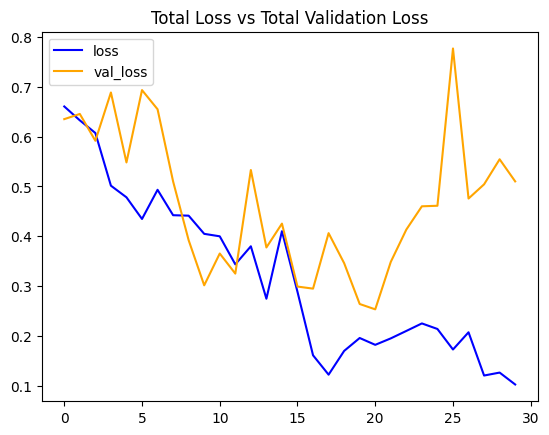

In [23]:
plot_metric(MobBiLSTM_model_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

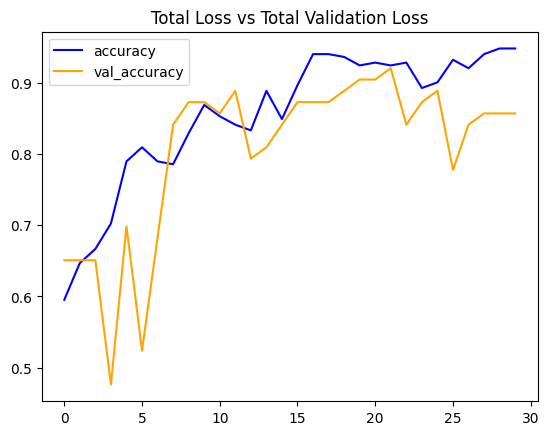

In [24]:
plot_metric(MobBiLSTM_model_history, 'accuracy', 'val_accuracy', 'Total Loss vs Total Validation Loss')

**Predicting the Test Set**

In [25]:
labels_predict = MoBiLSTM_model.predict(features_test)

2/2 ━━━━━━━━━━━━━━━━━━━━ 34s 17s/step


In [26]:
# Decoding the data to use in Metrics
labels_predict = np.argmax(labels_predict , axis=1)
labels_test_normal = np.argmax(labels_test , axis=1)

In [27]:
labels_test_normal.shape , labels_predict.shape

((35,), (35,))

**Accuracy Score**

In [28]:
from sklearn.metrics import accuracy_score
AccScore = accuracy_score(labels_predict, labels_test_normal)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.8


**Confusion Matrix**

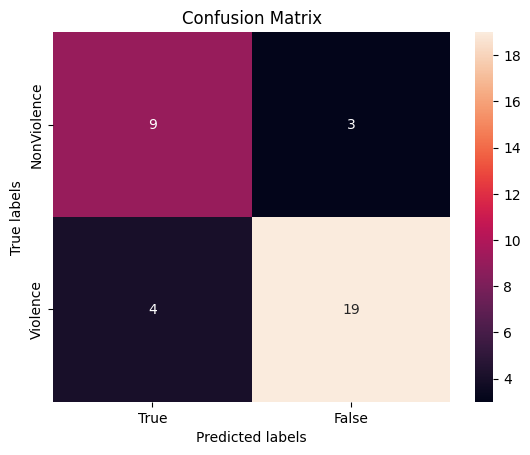

In [29]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

ax= plt.subplot()
cm=confusion_matrix(labels_test_normal, labels_predict)
sns.heatmap(cm, annot=True, fmt='g', ax=ax);

ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix');
ax.xaxis.set_ticklabels(['True', 'False']); ax.yaxis.set_ticklabels(['NonViolence', 'Violence']);

**Classification Report**

In [30]:
from sklearn.metrics import classification_report

ClassificationReport = classification_report(labels_test_normal,labels_predict)
print('Classification Report is : \n', ClassificationReport)

Classification Report is : 
               precision    recall  f1-score   support

           0       0.69      0.75      0.72        12
           1       0.86      0.83      0.84        23

    accuracy                           0.80        35
   macro avg       0.78      0.79      0.78        35
weighted avg       0.80      0.80      0.80        35



**Prediction Frame By Frame**

In [31]:
model = Sequential()
model.save("violence_detection_model.h5")


In [32]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):

    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'),
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))

    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)

    # Store the predicted class in the video.
    predicted_class_name = ''

    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():

        ok, frame = video_reader.read()

        if not ok:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)

        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:

            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_queue, axis = 0))[0]

            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)

            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]

        # Write predicted class name on top of the frame.
        if predicted_class_name == "violent":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)

        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)

    video_reader.release()
    video_writer.release()

In [33]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path):

    plt.figure(figsize=(20,15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Get Random Frames from the video then Sort it
    random_range = sorted(random.sample(range (SEQUENCE_LENGTH , frames_count ), 12))

    for counter, random_index in enumerate(random_range, 1):

        plt.subplot(5, 4, counter)

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)

        ok, frame = video_reader.read()

        if not ok:
          break

        frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

        plt.imshow(frame);ax.figure.set_size_inches(20,20);plt.tight_layout()

    video_reader.release()

In [34]:
# Construct the output video path.
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)

output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/

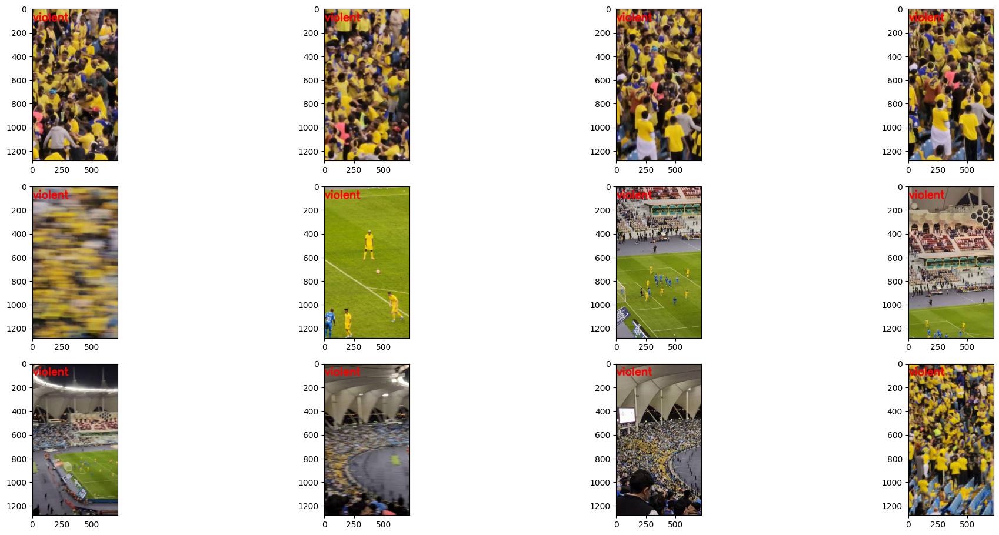

In [38]:
# Specifying video to be predicted
input_video_file_path = r"/content/Violence1.MP4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [39]:
# Play the actual video
Play_Video(input_video_file_path)

**Prediction For Video**

In [40]:
def predict_video(video_file_path, SEQUENCE_LENGTH):

    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Declare a list to store video frames we will extract.
    frames_list = []

    # Store the predicted class in the video.
    predicted_class_name = ''

    # Get the number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)

    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame.
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list
        frames_list.append(normalized_frame)

    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_list, axis = 0))[0]

    # Get the index of class with highest probability.
    predicted_label = np.argmax(predicted_labels_probabilities)

    # Get the class name using the retrieved index.
    predicted_class_name = CLASSES_LIST[predicted_label]

    # Display the predicted class along with the prediction confidence.
    print(f'Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')

    video_reader.release()

In [41]:
# Specifying video to be predicted
input_video_file_path = "/content/Violence1.MP4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Predicted: violent
Confidence: 0.9922210574150085


In [42]:
MoBiLSTM_model.save("violence_detection_model.keras")

In [43]:
pip install gradio tensorflow keras opencv-python numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.9/46.9 MB 17.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.2/322.2 kB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.4/11.4 MB 121.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.3/62.3 kB 6.2 MB/s eta 0:00:00


In [ ]:
# -*- coding: utf-8 -*-
import gradio as gr
import random
import time
from datetime import datetime # Optional: for timestamps in logs
import os # Needed for checking placeholder file existence

# --- Simulation of Complex Backend Analysis ---
# (Keep the simulate_media_analysis function exactly as before)
def simulate_media_analysis(uploaded_media_data):
    """
    Simulates the analysis of an uploaded image or video.
    Returns a dictionary with assessment results.
    """
    print(f"[{datetime.now()}] Simulating analysis for media type: {type(uploaded_media_data)}")
    processing_time = random.uniform(1.5, 3.5)
    print(f"[{datetime.now()}] Simulating analysis... (approx {processing_time:.1f}s)")
    time.sleep(processing_time)
    scenarios = [
        # ...(keep the scenarios list as before)...
         {
            "assessment": "Likely Safe ✅",
            "description": "Simulated analysis suggests a calm environment (e.g., park, quiet room) with no immediate visual threats detected.",
            "details": {"objects": ["trees", "bench"], "actions": ["static scene"], "hazards": ["none detected"]},
            "confidence_note": "Confidence: High (Simulated)"
        },
        {
            "assessment": "Caution Advised 🤔",
            "description": "Simulated analysis detected elements requiring attention (e.g., moderate crowding, unusual object placement, unclear activity).",
            "details": {"objects": ["multiple people", "bags"], "actions": ["loitering (simulated)"], "hazards": ["none detected"]},
            "confidence_note": "Confidence: Medium (Simulated)"
        },
        {
            "assessment": "Potential Danger Detected ⚠️",
            "description": "Simulated analysis indicates potential signs of conflict, hazard, or distress (e.g., aggressive postures, fire-like visual patterns).",
            "details": {"objects": ["people", "vehicle"], "actions": ["agitated movement (simulated)"], "hazards": ["possible conflict"]},
            "confidence_note": "Confidence: Medium-High (Simulated)"
        },
         {
            "assessment": "High Risk Identified 🔥", # Example for a specific hazard
            "description": "Simulated analysis strongly suggests a specific hazard (e.g., visual patterns consistent with fire or structural issue). Immediate caution required.",
            "details": {"objects": ["smoke pattern", "obstructed view"], "actions": ["static scene"], "hazards": ["fire/smoke (simulated)"]},
            "confidence_note": "Confidence: High (Simulated)"
        }
    ]
    chosen_scenario = random.choice(scenarios)
    print(f"[{datetime.now()}] Simulation result: {chosen_scenario['assessment']}")
    return chosen_scenario

# --- Chatbot Logic ---
# (Keep the last_analysis_result variable and chatbot_response function exactly as before)
last_analysis_result = None

def chatbot_response(message, history):
    """
    Handles user messages and generates chatbot responses.
    Uses Gradio's multimodal input format.
    """
    global last_analysis_result
    text_input = ""
    media_input = None

    if isinstance(message, dict):
        text_input = message.get('text', '')
        if message.get('files') and isinstance(message['files'], list) and len(message['files']) > 0:
            media_input = message['files'][0]

    print(f"[{datetime.now()}] Received input - Text: '{text_input}', Media detected: {media_input is not None}")

    bot_response = ""

    if media_input:
        yield "Analyzing the uploaded media... This is a simulation and may take a few seconds. ⏳"
        analysis_result = simulate_media_analysis(media_input)
        last_analysis_result = analysis_result

        bot_response = f"**Analysis Complete (Simulated)**\n\n"
        bot_response += f"**Assessment:** {analysis_result['assessment']}\n\n"
        bot_response += f"**Description:** {analysis_result['description']}\n\n"
        bot_response += f"**Key Details (Simulated):**\n"
        bot_response += f"  - Objects: {', '.join(analysis_result['details'].get('objects', ['N/A']))}\n"
        bot_response += f"  - Actions: {', '.join(analysis_result['details'].get('actions', ['N/A']))}\n"
        bot_response += f"  - Hazards: {', '.join(analysis_result['details'].get('hazards', ['N/A']))}\n\n"
        bot_response += f"*{analysis_result.get('confidence_note', '')}*\n\n"
        bot_response += ("--- \n*⚠️ **Reminder:** This analysis is **simulated** based on predefined scenarios "
                         "and does not reflect true AI understanding or guarantee accuracy. "
                         "Do not rely on this for real-world safety decisions.*")

    elif text_input:
        # ...(keep the text handling logic as before)...
        text_lower = text_input.lower()
        if "hello" in text_lower or "hi" in text_lower:
            bot_response = ("Hello! I'm a demo chatbot. Upload an image or video, and I'll provide a "
                            "*simulated* safety analysis based on visual content.")
        elif last_analysis_result and ("details" in text_lower or "objects" in text_lower or "actions" in text_lower):
            bot_response = f"Regarding the last analysis:\n"
            bot_response += f"  - Simulated Objects: {', '.join(last_analysis_result['details'].get('objects', ['N/A']))}\n"
            bot_response += f"  - Simulated Actions: {', '.join(last_analysis_result['details'].get('actions', ['N/A']))}\n"
            bot_response += f"  - Simulated Hazards: {', '.join(last_analysis_result['details'].get('hazards', ['N/A']))}"
        elif last_analysis_result and ("assessment" in text_lower or "result" in text_lower or "safe" in text_lower or "danger" in text_lower):
             bot_response = f"The overall simulated assessment for the last media was: **{last_analysis_result['assessment']}**"
        elif "help" in text_lower:
             bot_response = "You can upload an image or video file. After analysis, you can ask simple follow-up questions like 'what were the details?' or 'what was the assessment?'."
        else:
            bot_response = ("I can provide a *simulated* analysis if you upload an image or video. "
                            "You can also ask basic questions about the last analysis performed.")

    else:
        bot_response = "Sorry, I didn't get that. Please type a message or upload an image/video file."

    yield bot_response


# --- Create and Launch the Gradio Chat Interface (Corrected) ---

# Define Chatbot component - Corrected according to warnings
chatbot_component = gr.Chatbot(
    label="Analysis Chat",
    # Removed bubble_full_width (deprecated)
    type="messages", # Added type='messages' as recommended
    height=500
    )

# Define Input component - Stays the same
input_component = gr.MultimodalTextbox(
    file_types=["image", "video"],
    placeholder="Type a message or upload an image/video...",
    label="Your Input"
    )

# Prepare example list conditionally
# Create a dummy file if needed for examples, otherwise disable them.
example_file_exists = False
placeholder_file = "placeholder_image.png" # Define placeholder name
if not os.path.exists(placeholder_file):
    try:
        # Attempt to create a tiny dummy PNG file if PIL is available
        from PIL import Image
        img = Image.new('RGB', (60, 30), color = (210, 210, 210))
        img.save(placeholder_file)
        print(f"Created dummy '{placeholder_file}' for examples.")
        example_file_exists = True
    except ImportError:
        print(f"Warning: PIL not found. Cannot create dummy '{placeholder_file}'. Examples requiring files will be disabled.")
    except Exception as e:
         print(f"Warning: Could not create dummy '{placeholder_file}': {e}. Examples requiring files will be disabled.")
else:
    example_file_exists = True

examples_list = [
        {"text": "hello"},
        {"text": "What was the assessment?"}, # Example follow-up (only works after an analysis)
    ]
if example_file_exists:
    examples_list.insert(0, {'text': 'Check this image', 'files': [placeholder_file]})


# Define the interface using ChatInterface - Corrected arguments
iface = gr.ChatInterface(
    fn=chatbot_response,
    chatbot=chatbot_component,
    textbox=input_component,
    title="Muraqib - مُراقب 🤖",
    description="""**DEMO ONLY - Analysis is SIMULATED**
    Upload an image or video to get a *simulated* assessment of potential safety risks based on visual content.
    You can ask follow-up questions like 'what details were found?' about the last analysis.""",
    theme=gr.themes.Soft(primary_hue="red", secondary_hue="rose"),
    examples=examples_list, # Use the prepared list
    cache_examples=False,
    # Removed unexpected keyword arguments: retry_btn, undo_btn, clear_btn
    # These buttons should appear by default if supported by ChatInterface
)

if __name__ == "__main__":
    print("Launching Gradio Simulated Chatbot...")
    iface.launch(debug=True, share=True) # Set share=True

Created dummy 'placeholder_image.png' for examples.
Launching Gradio Simulated Chatbot...


/usr/local/lib/python3.11/dist-packages/gradio/chat_interface.py:321: UserWarning: The gr.ChatInterface was not provided with a type, so the type of the gr.Chatbot, 'messages', will be used.
  warnings.warn(


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://9fe8e160a37ca746e1.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


[2025-04-10 19:55:25.803332] Received input - Text: '', Media detected: True
[2025-04-10 19:55:25.805719] Simulating analysis for media type: <class 'str'>
[2025-04-10 19:55:25.805750] Simulating analysis... (approx 1.9s)
[2025-04-10 19:55:27.737704] Simulation result: Caution Advised 🤔


ERROR:    Exception in ASGI application
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/uvicorn/protocols/http/h11_impl.py", line 403, in run_asgi
    result = await app(  # type: ignore[func-returns-value]
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/uvicorn/middleware/proxy_headers.py", line 60, in __call__
    return await self.app(scope, receive, send)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/fastapi/applications.py", line 1054, in __call__
    await super().__call__(scope, receive, send)
  File "/usr/local/lib/python3.11/dist-packages/starlette/applications.py", line 112, in __call__
    await self.middleware_stack(scope, receive, send)
  File "/usr/local/lib/python3.11/dist-packages/starlette/middleware/errors.py", line 187, in __call__
    raise exc
  File "/usr/local/lib/python3.11/dist-packages/starlette/middleware/errors.py",